In [1]:
import pandas as pd
import numpy as np
import os
import openpyxl
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
from itertools import chain
from prophet import Prophet

# Data based on different AC types and different distances

In [2]:
url="/home/anamaria/code/nusero92/aviation/avia_paodis__custom_9158704_spreadsheet.xlsx"
nat=pd.ExcelFile(url)
sheet_names_nat_all_ac = list(chain(nat.sheet_names[8:14], nat.sheet_names[15:21], nat.sheet_names[22:28], nat.sheet_names[29:35], nat.sheet_names[36:42], nat.sheet_names[43:49]))
dfs_nat_all_ac = [nat.parse(sheet_name) for sheet_name in sheet_names_nat_all_ac]

In [3]:
base_nat_all_ac = dfs_nat_all_ac[0]

try:
    # Loop through the rest of the DataFrames and join them one by one, using sheet names as suffixes
    for i, df in enumerate(dfs_nat_all_ac[1:], start=1):  # Start at 1 to include all but the first df
        # Use the sheet name for the suffix. Ensure it's a valid string that can be used as a suffix.
        # For example, replace spaces with underscores if necessary
        sheet_name_suffix_nat = sheet_names_nat_all_ac[i].replace(' ', '_')
        suffixes_nat = ('', f'_{sheet_name_suffix_nat}')  # Custom suffix for each joined DataFrame
        
        # Perform the merge operation and update base_df_all_ac each time
        base_nat_all_ac = pd.merge(base_nat_all_ac, df, on='Country', how='outer', suffixes=suffixes_nat)
except Exception as e:
    print(f"An error occurred: {e}")

In [4]:
base_nat_all_ac=base_nat_all_ac.replace(":", 0)

In [5]:
#base_nat_all_ac = base_nat_all_ac[base_nat_all_ac["Country"] != "nb"]

In [6]:
base_nat_all_ac.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36 entries, 0 to 35
Columns: 361 entries, Country to 2022_oth>2000km
dtypes: int64(360), object(1)
memory usage: 101.8+ KB


In [7]:
# Melt the DataFrame to go from wide to long format
df_ac_type = pd.melt(base_nat_all_ac, id_vars=['Country'], var_name='Year_AcType_Distance', value_name='Value')

In [8]:
df_ac_type.Year_AcType_Distance.unique()

array(['2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020',
       '2021', '2022', '2013_jj-300-499km', '2014_jj-300-499km',
       '2015_jj-300-499km', '2016_jj-300-499km', '2017_jj-300-499km',
       '2018_jj-300-499km', '2019_jj-300-499km', '2020_jj-300-499km',
       '2021_jj-300-499km', '2022_jj-300-499km', '2013_jj-500-999km',
       '2014_jj-500-999km', '2015_jj-500-999km', '2016_jj-500-999km',
       '2017_jj-500-999km', '2018_jj-500-999km', '2019_jj-500-999km',
       '2020_jj-500-999km', '2021_jj-500-999km', '2022_jj-500-999km',
       '2013_jj-1000-1499km', '2014_jj-1000-1499km',
       '2015_jj-1000-1499km', '2016_jj-1000-1499km',
       '2017_jj-1000-1499km', '2018_jj-1000-1499km',
       '2019_jj-1000-1499km', '2020_jj-1000-1499km',
       '2021_jj-1000-1499km', '2022_jj-1000-1499km',
       '2013_jj-1500-2000km', '2014_jj-1500-2000km',
       '2015_jj-1500-2000km', '2016_jj-1500-2000km',
       '2017_jj-1500-2000km', '2018_jj-1500-2000km',
       '2019_jj-1500

In [9]:
df_ac_type[['Year', 'AcType']] = df_ac_type['Year_AcType_Distance'].str.extract(
    r'(\d{4})'                                        # Capture the year
    r'(?:_([a-z]{2,3}))?' )                            # Optionally capture the aircraft type                      


In [10]:
# Revised approach focusing on distance extraction
df_ac_type['Distance'] = df_ac_type['Year_AcType_Distance'].str.extract(
    r'(?:\d{4}_?[a-zA-Z]*[>_]?-?)(\d+km|\d+-\d+km|[><]\d+km)'
)

In [11]:
# Convert data types
df_ac_type['Year'] = pd.to_numeric(df_ac_type['Year'])
df_ac_type['Value'] = pd.to_numeric(df_ac_type['Value'], errors='coerce')  # Convert to numeric, make errors NaN

In [12]:
df_ac_type["AcType"].fillna("jj", inplace=True)

In [13]:
df_ac_type["Distance"].fillna("<300km", inplace=True)

In [14]:
df_ac_type

,Country,Year_AcType_Distance,Value,Year,AcType,Distance
0,Belgium,2013,0,2013,jj,<300km
1,Bulgaria,2013,1252,2013,jj,<300km
2,Czechia,2013,0,2013,jj,<300km
3,Denmark,2013,0,2013,jj,<300km
4,Germany,2013,5680,2013,jj,<300km
...,...,...,...,...,...,...
12955,Bosnia and Herzegovina,2022_oth>2000km,0,2022,oth,2000km
12956,Montenegro,2022_oth>2000km,0,2022,oth,2000km
12957,North Macedonia,2022_oth>2000km,0,2022,oth,2000km
12958,Serbia,2022_oth>2000km,0,2022,oth,2000km


In [15]:
df_ac_type.isna().sum()

Country                 0
Year_AcType_Distance    0
Value                   0
Year                    0
AcType                  0
Distance                0
dtype: int64

In [16]:
df_ac_type.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12960 entries, 0 to 12959
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Country               12960 non-null  object
 1   Year_AcType_Distance  12960 non-null  object
 2   Value                 12960 non-null  int64 
 3   Year                  12960 non-null  int64 
 4   AcType                12960 non-null  object
 5   Distance              12960 non-null  object
dtypes: int64(2), object(4)
memory usage: 607.6+ KB


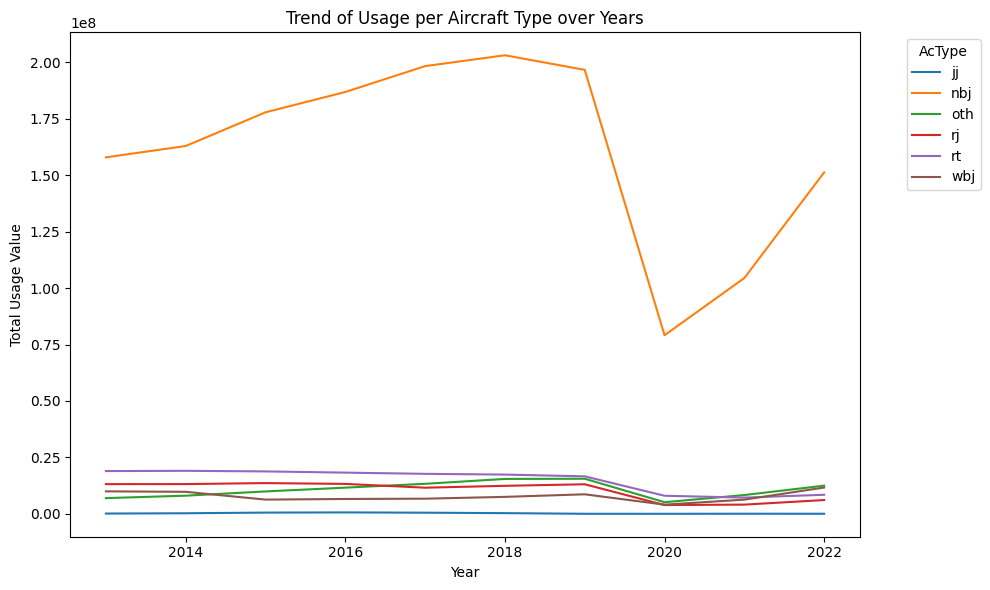

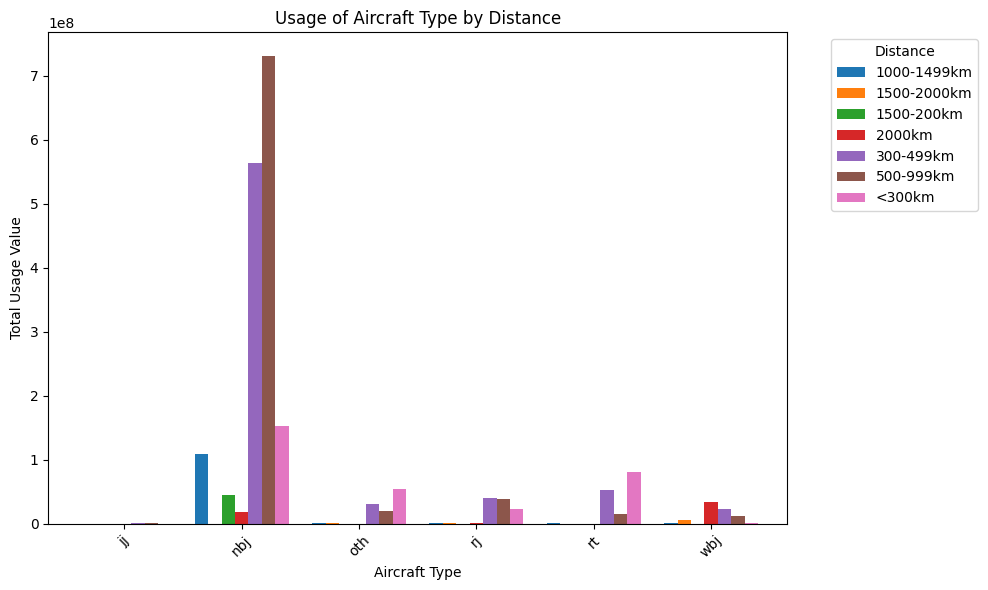

In [17]:
#Trend Analysis per Aircraft Type and Year
trend_analysis = df_ac_type.groupby(['Year', 'AcType'])['Value'].sum().unstack()
trend_analysis.plot(kind='line', figsize=(10, 6))
plt.title('Trend of Usage per Aircraft Type over Years')
plt.ylabel('Total Usage Value')
plt.xlabel('Year')
plt.legend(title='AcType', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Distance Usage Analysis
distance_usage = df_ac_type.groupby(['AcType', 'Distance'])['Value'].sum().unstack()
distance_usage.plot(kind='bar', figsize=(10, 6), width=0.8)
plt.title('Usage of Aircraft Type by Distance')
plt.ylabel('Total Usage Value')
plt.xlabel('Aircraft Type')
plt.xticks(rotation=45)
plt.legend(title='Distance', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


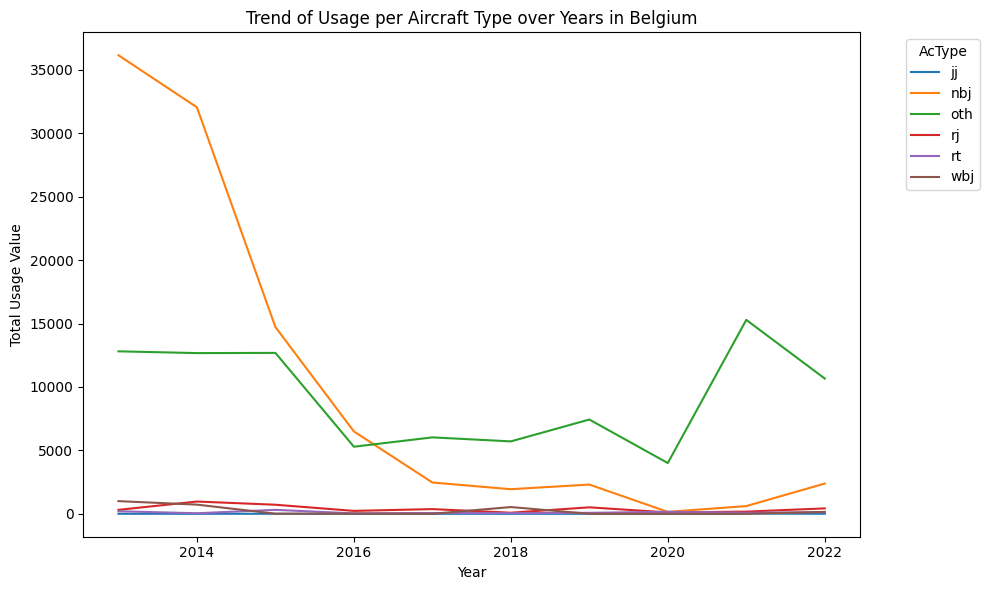

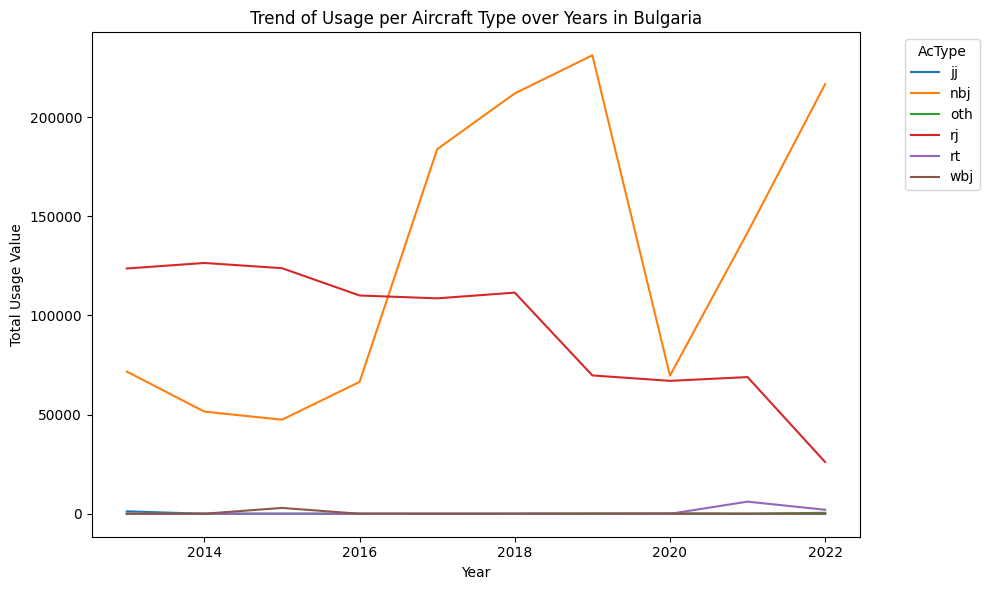

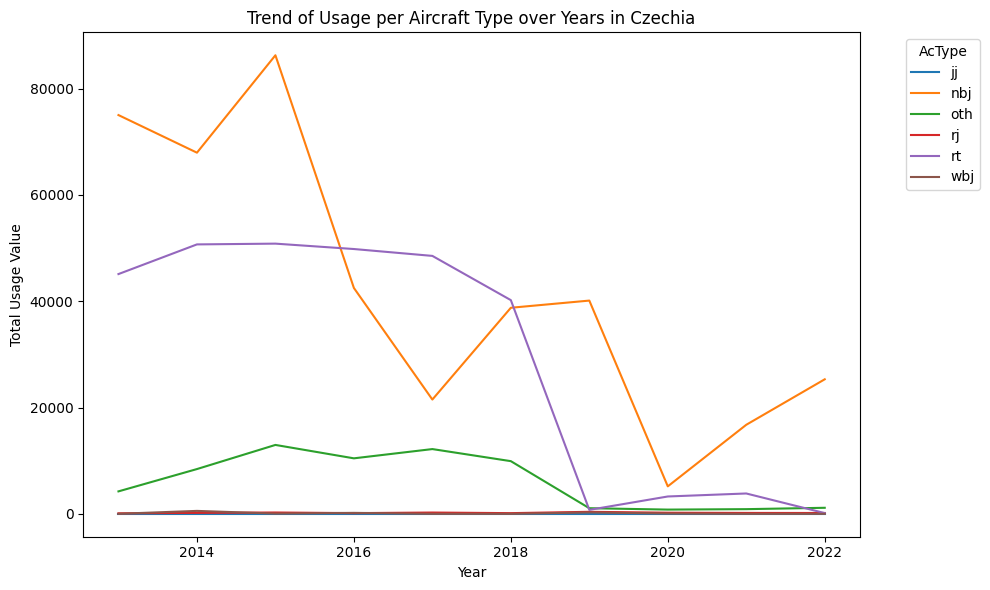

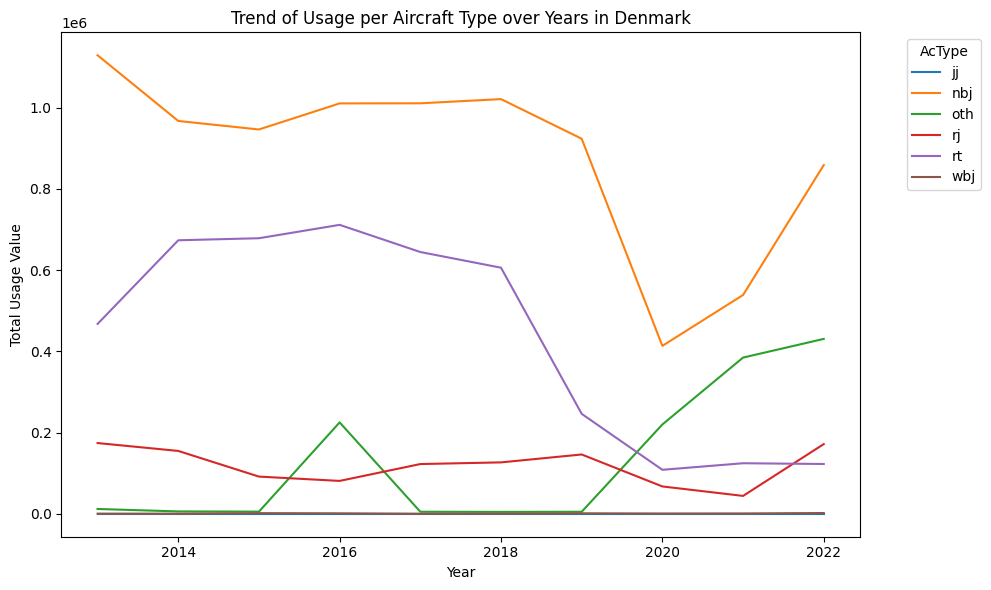

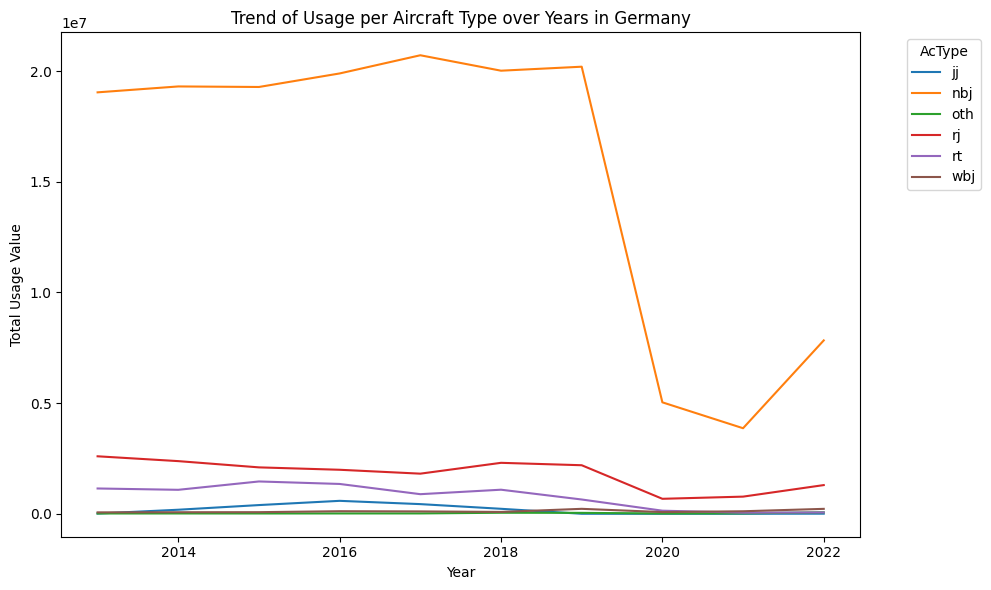

...

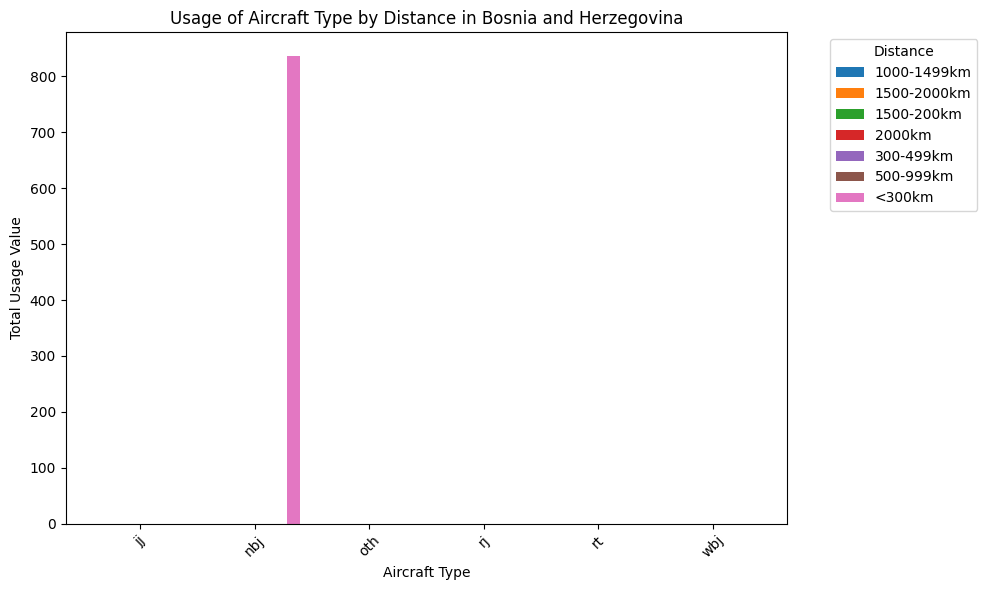

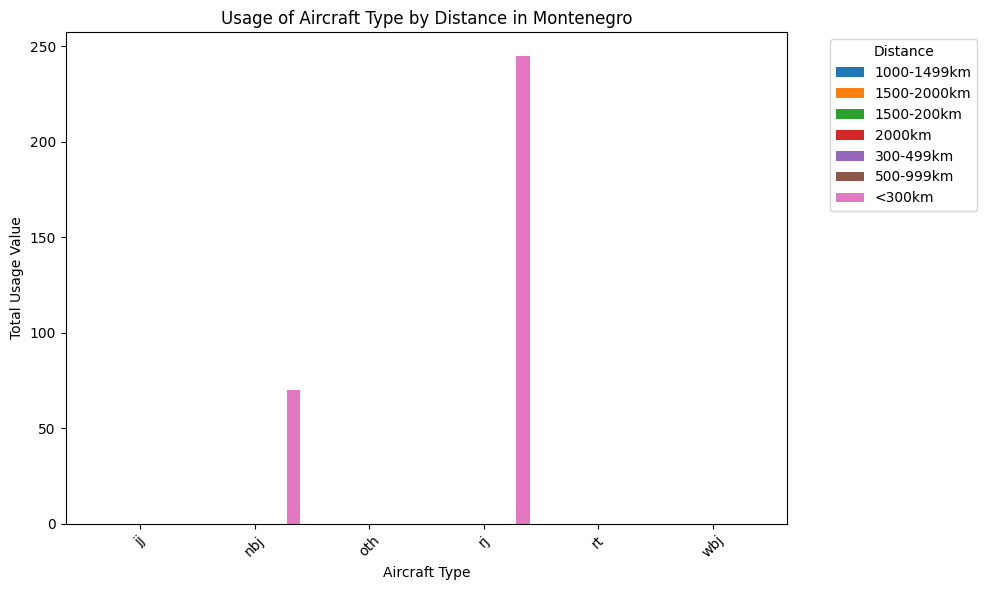

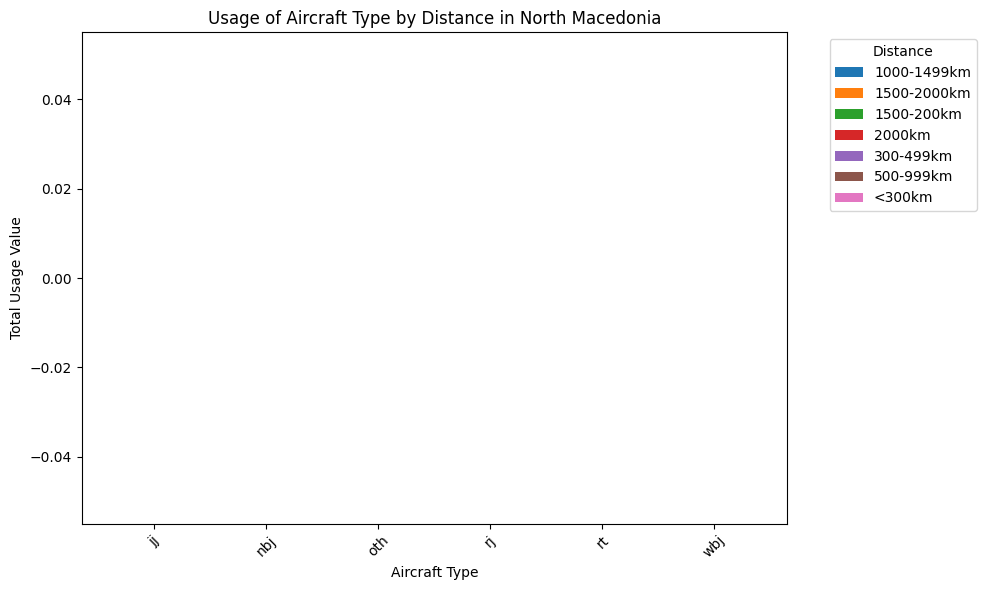

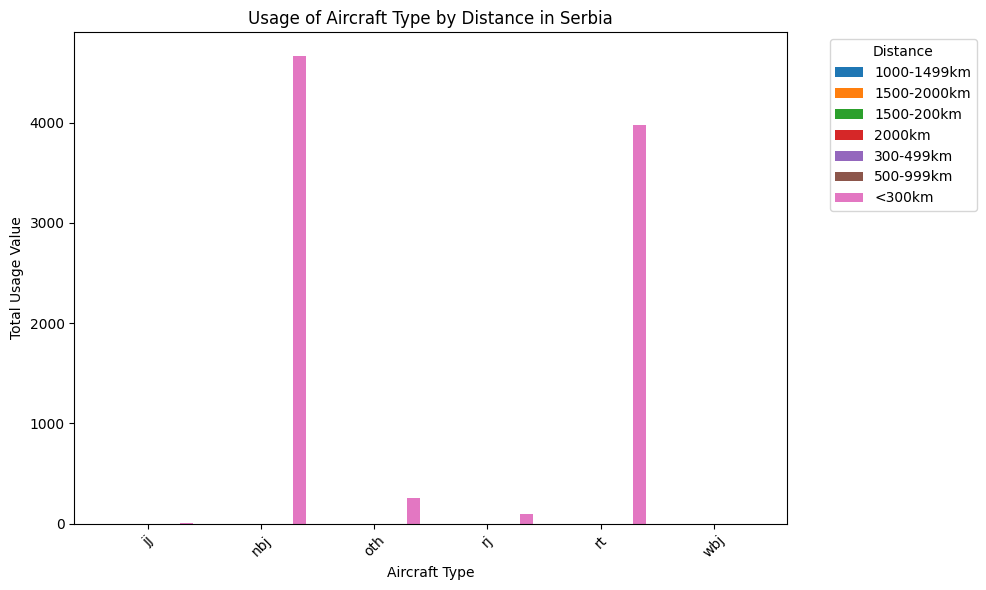

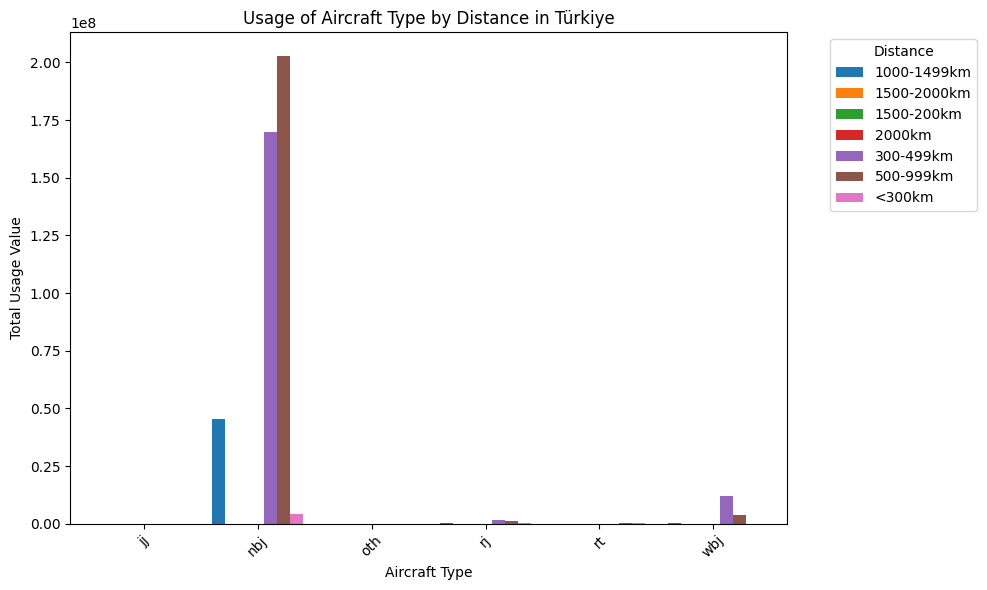

In [18]:
#Trend Analysis per Country, Aircraft Type, and Year
for country in df_ac_type['Country'].unique():
    df_filtered = df_ac_type[df_ac_type['Country'] == country]
    trend_analysis = df_filtered.groupby(['Year', 'AcType'])['Value'].sum().unstack()
    trend_analysis.plot(kind='line', figsize=(10, 6))
    plt.title(f'Trend of Usage per Aircraft Type over Years in {country}')
    plt.ylabel('Total Usage Value')
    plt.xlabel('Year')
    plt.legend(title='AcType', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

#  Distance Usage Analysis per Country
for country in df_ac_type['Country'].unique():
    df_filtered = df_ac_type[df_ac_type['Country'] == country]
    distance_usage = df_filtered.groupby(['AcType', 'Distance'])['Value'].sum().unstack()
    distance_usage.plot(kind='bar', figsize=(10, 6), width=0.8)
    plt.title(f'Usage of Aircraft Type by Distance in {country}')
    plt.ylabel('Total Usage Value')
    plt.xlabel('Aircraft Type')
    plt.xticks(rotation=45)
    plt.legend(title='Distance', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


In [19]:
# List of all countries
countries = df_ac_type['Country'].unique()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('Trend of Usage per Aircraft Type over Years', 'Usage of Aircraft Type by Distance'))

# Initialize traces for the first plot (Trend Analysis) and second plot (Distance Usage) with all invisible
for country in countries:
    filtered_df = df_ac_type[df_ac_type['Country'] == country]
    
    # Trend Analysis Data Preparation
    trend_analysis = filtered_df.groupby(['Year', 'AcType'])['Value'].sum().reset_index()
    for ac_type in trend_analysis['AcType'].unique():
        df_actype = trend_analysis[trend_analysis['AcType'] == ac_type]
        fig.add_trace(go.Scatter(x=df_actype['Year'], y=df_actype['Value'], mode='lines',
                                 name=ac_type, legendgroup=country, showlegend=False, visible=False), row=1, col=1)
    
    # Distance Usage Data Preparation
    distance_usage = filtered_df.groupby(['AcType', 'Distance'])['Value'].sum().reset_index()
    for ac_type in distance_usage['AcType'].unique():
        for distance in distance_usage['Distance'].unique():
            df_filtered = distance_usage[(distance_usage['AcType'] == ac_type) & (distance_usage['Distance'] == distance)]
            if not df_filtered.empty:
                fig.add_trace(go.Bar(x=[ac_type], y=df_filtered['Value'], name=distance, legendgroup=f"{country}_{distance}", showlegend=False, visible=False), row=1, col=2)

# Define buttons for the dropdown
buttons = []

# Make traces of the first country visible and adjust titles dynamically
first_country = countries[0]
for i, trace in enumerate(fig.data):
    if trace.legendgroup.startswith(first_country):
        fig.data[i].visible = True
        if i < len(fig.data) // 2:  # Assuming the first half of traces are for the first plot
            fig.data[i].showlegend = True

# Update buttons for each country to control visibility across both plots
for country in countries:
    args = [{"visible": [country == trace.legendgroup or f"{country}_" in trace.legendgroup for trace in fig.data]}]
    
    buttons.append(dict(label=country, method="update", args=args))

# Adding dropdown menus to the layout
fig.update_layout(
    updatemenus=[{
        "buttons": buttons,
        "direction": "down",
        "pad": {"r": 10, "t": 10},
        "showactive": True,
        "x": 0.1,
        "xanchor": "left",
        "y": 1.2,
        "yanchor": "top"
    }]
)

fig.show()


In [20]:
countries = df_ac_type['Country'].unique()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('Prediction of Usage per Aircraft Type over Years', 'Prediction of Aircraft Type by Distance'))

# Initialize traces for the first plot (Trend Analysis) and second plot (Distance Usage)
for country in countries:
    filtered_df = df_ac_type[df_ac_type['Country'] == country]
    
    # Trend Analysis Data Preparation
    trend_analysis = filtered_df.groupby(['Year', 'AcType'])['Value'].sum().reset_index()
    for ac_type in trend_analysis['AcType'].unique():
        df_actype = trend_analysis[trend_analysis['AcType'] == ac_type]
        
        if len(df_actype) > 1:  # Ensure there's enough data for regression
            # Linear Regression Model
            X = df_actype[['Year']].values.reshape(-1, 1)
            y = df_actype['Value']
            model = LinearRegression()
            
            try:
                model.fit(X, y)
                
                # Predict future values
                future_years = np.array([[year] for year in range(2023, 2028)])  # Example: Predicting for 2023 to 2027
                future_values = model.predict(future_years)
                
                # Add historical trend line
                fig.add_trace(go.Scatter(x=df_actype['Year'], y=df_actype['Value'], mode='lines', name=f"{ac_type} {country}", visible=False), row=1, col=1)
                
                # Add predicted future trend line
                fig.add_trace(go.Scatter(x=future_years.flatten(), y=future_values, mode='lines+markers', name=f"Predicted {ac_type} {country}", visible=False, line=dict(dash='dot')), row=1, col=1)
            except Exception as e:
                print(f"Error fitting model for {ac_type} in {country}: {e}")

# Define buttons for the dropdown
buttons = []

for country in countries:
    country_visible = [True if trace.name.endswith(country) else False for trace in fig.data]
    buttons.append(dict(label=country, method="update", args=[{"visible": country_visible}]))

# Adding dropdown menus to the layout
fig.update_layout(
    updatemenus=[{
        "buttons": buttons,
        "direction": "down",
        "pad": {"r": 10, "t": 10},
        "showactive": True,
        "x": 0.1,
        "xanchor": "left",
        "y": 1.15,
        "yanchor": "top"
    }],
    title_text="Aircraft Usage Analysis"
)

fig.show()


In [21]:
countries = df_ac_type['Country'].unique()

# Predicting for 2023 to 2027
future_years = np.array([[year] for year in range(2023, 2028)]) 

for country in countries:
    filtered_df = df_ac_type[df_ac_type['Country'] == country]
    
    # Trend Analysis for each Aircraft Type
    trend_analysis = filtered_df.groupby(['Year', 'AcType'])['Value'].sum().reset_index()
    for ac_type in trend_analysis['AcType'].unique():
        df_actype = trend_analysis[trend_analysis['AcType'] == ac_type]
        
        if len(df_actype) > 1:  # Ensure there's enough data for regression
            X = df_actype[['Year']].values.reshape(-1, 1)
            y = df_actype['Value']
            model = LinearRegression().fit(X, y)
            
            # Predict future values
            future_values = model.predict(future_years)
            
            # Create figure for Trend Analysis
            fig_trend = go.Figure()
            fig_trend.add_trace(go.Scatter(x=df_actype['Year'], y=df_actype['Value'], mode='lines+markers', name='Historical Data'))
            fig_trend.add_trace(go.Scatter(x=future_years.flatten(), y=future_values, mode='lines+markers', name='Predictions', line=dict(dash='dot')))
            fig_trend.update_layout(title=f'Trend Analysis for {country} - {ac_type}', xaxis_title='Year', yaxis_title='Value', template='plotly_white')
            fig_trend.show()
            
        else:
            print(f"Not enough data to predict trend for {ac_type} in {country}.")
    

    distance_usage = filtered_df.groupby(['AcType', 'Distance'])['Value'].sum().reset_index()
    for ac_type in distance_usage['AcType'].unique():
        fig_distance = go.Figure()
        df_ac_distance = distance_usage[distance_usage['AcType'] == ac_type]
        for _, row in df_ac_distance.iterrows():
            fig_distance.add_trace(go.Bar(x=[row['Distance']], y=[row['Value']], name=ac_type))
        fig_distance.update_layout(title=f'Usage of {ac_type} by Distance for {country}', xaxis_title='Distance', yaxis_title='Value', template='plotly_white')
        fig_distance.show()

In [23]:
"""def predict_distance_usage_growth(filtered_df, future_years):
    """
    A simplified approach to predict future usage by distance based on overall growth rates.
    This assumes that the growth rate observed in the trend analysis can be applied to distance categories.
    """
    # Example: Calculate the overall growth rate from trend analysis
    yearly_totals = filtered_df.groupby('Year')['Value'].sum()
    X = np.array(yearly_totals.index).reshape(-1, 1)
    y = yearly_totals.values
    model = LinearRegression().fit(X, y)
    
    # Predict future total values
    future_values_total = model.predict(future_years)
    
    # Calculate the growth rate
    if len(y) > 1:
        last_year_total = y[-1]
        growth_rate = (future_values_total[0] - last_year_total) / last_year_total
    else:
        growth_rate = 0
    
    return growth_rate

# Apply this in your plotting and prediction loop for distance usage
for country in countries:
    filtered_df = df_ac_type[df_ac_type['Country'] == country]
    
    # Assume future_years is defined as np.array([[year] for year in range(2023, 2028)])
    growth_rate = predict_distance_usage_growth(filtered_df, future_years)
    
    # Now, apply this growth rate to predict future usage by distance
    distance_usage = filtered_df.groupby(['AcType', 'Distance'])['Value'].sum().reset_index()
    
   
    for ac_type in distance_usage['AcType'].unique():
        fig_distance = go.Figure()
        df_ac_distance = distance_usage[distance_usage['AcType'] == ac_type]
        for _, row in df_ac_distance.iterrows():
            future_value = row['Value'] * (1 + growth_rate)
            # Plot historical data
            fig_distance.add_trace(go.Bar(x=[row['Distance']], y=[row['Value']], name=ac_type))
            # Plot predicted future value
            fig_distance.add_trace(go.Bar(x=[row['Distance']], y=[future_value], name=f"Predicted {ac_type}"))
        
        fig_distance.update_layout(title=f'Usage of {ac_type} by Distance for {country} (with Predictions)', xaxis_title='Distance', yaxis_title='Value', template='plotly_white')
        fig_distance.show()
"""

IndentationError: unexpected indent (3224666000.py, line 3)